In [111]:
# İlgili kütüphaneler import edilir
import pandas as pd
import numpy as np
import seaborn as sns
import missingno
import matplotlib.pyplot as plt
from collections import Counter
%matplotlib inline
from warnings import filterwarnings
filterwarnings('ignore')

In [112]:
# Veri setini okumak
df = pd.read_csv("train.csv",delimiter=",")
df.head()

,id,Sex,Length,Diameter,Height,Whole weight,Whole weight.1,Whole weight.2,Shell weight,Rings
0,0,F,0.550,0.430,0.150,0.7715,0.3285,0.1465,0.2400,11
1,1,F,0.630,0.490,0.145,1.1300,0.4580,0.2765,0.3200,11
2,2,I,0.160,0.110,0.025,0.0210,0.0055,0.0030,0.0050,6
3,3,M,0.595,0.475,0.150,0.9145,0.3755,0.2055,0.2500,10
4,4,I,0.555,0.425,0.130,0.7820,0.3695,0.1600,0.1975,9


In [113]:
df = df.drop(columns="id")

In [114]:
#Toplam satır ve sütun sayısına bakmak
df.shape

(90615, 9)

In [115]:
# Toplam kaç tane eksik değer var
df.isnull().sum().sum()

0

In [116]:
numerical_features1 = [feature for feature in df.columns if df[feature].dtypes != 'O']
print('Number of numerical variables: ', len(numerical_features1))
# sayısal değişkenleri görelim
df[numerical_features1].head()

Number of numerical variables:  8


,Length,Diameter,Height,Whole weight,Whole weight.1,Whole weight.2,Shell weight,Rings
0,0.550,0.430,0.150,0.7715,0.3285,0.1465,0.2400,11
1,0.630,0.490,0.145,1.1300,0.4580,0.2765,0.3200,11
2,0.160,0.110,0.025,0.0210,0.0055,0.0030,0.0050,6
3,0.595,0.475,0.150,0.9145,0.3755,0.2055,0.2500,10
4,0.555,0.425,0.130,0.7820,0.3695,0.1600,0.1975,9


[]

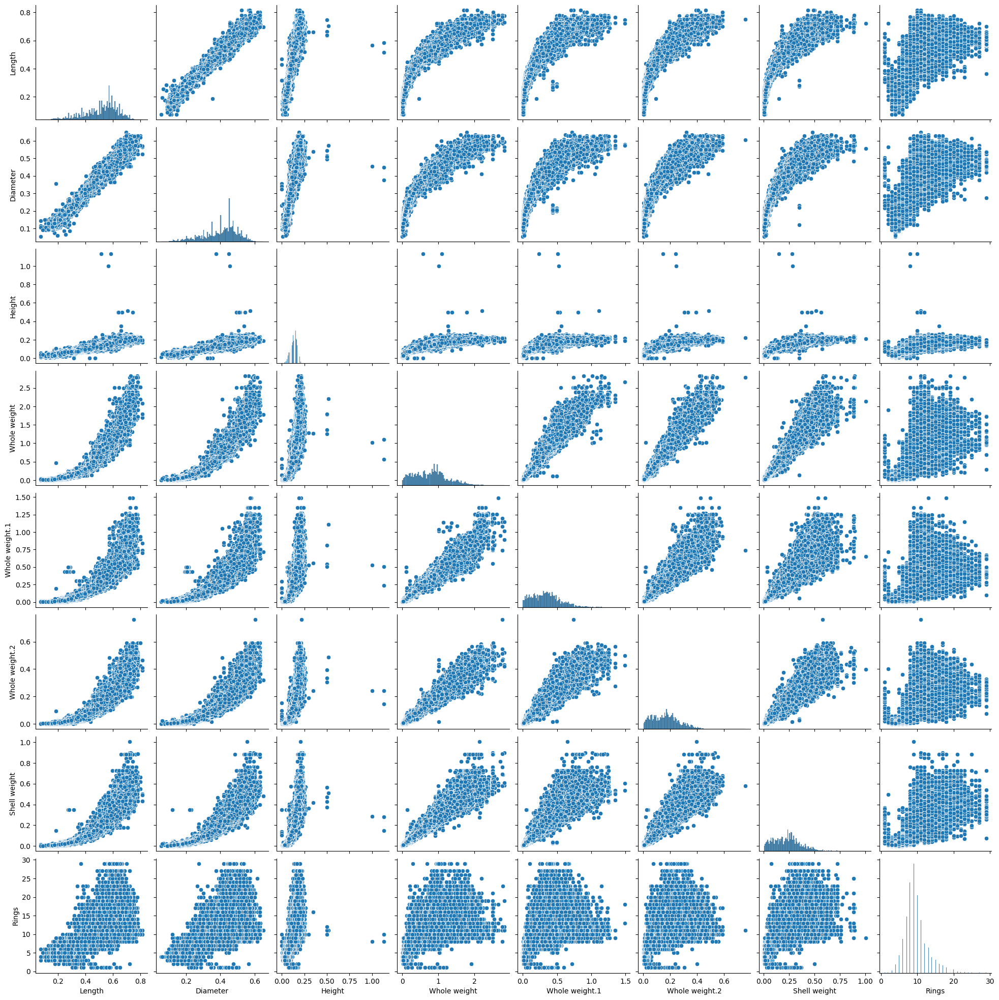

In [117]:
sns.pairplot(df[numerical_features1])
plt.plot()

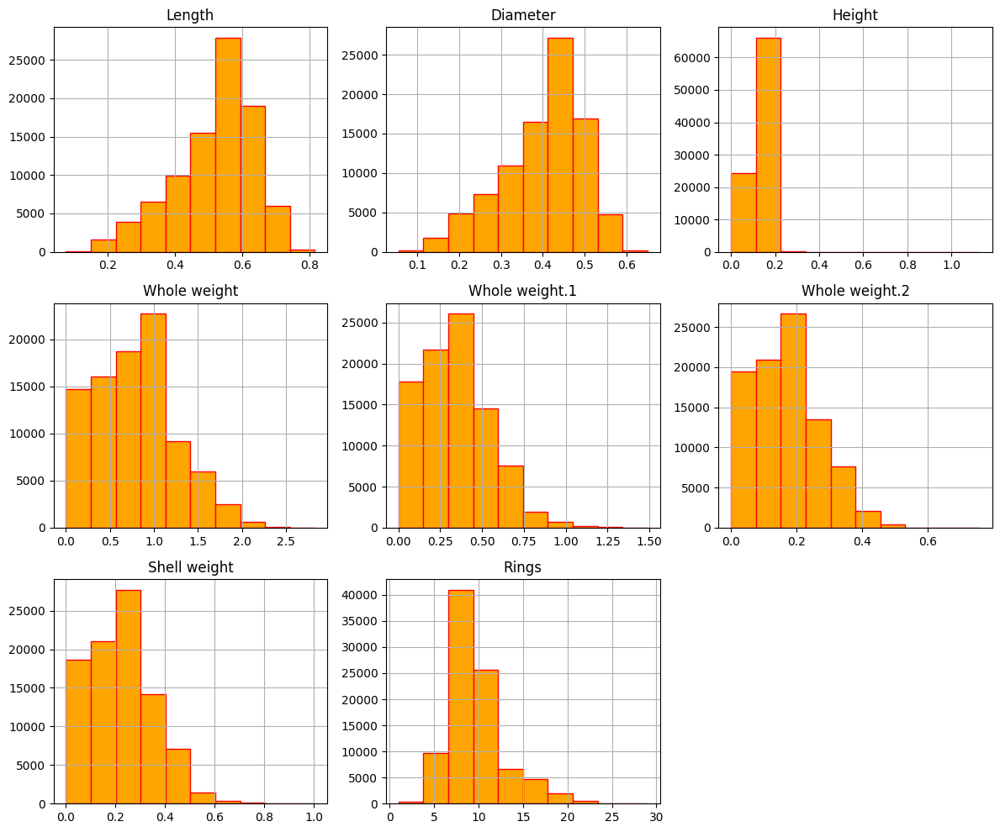

In [118]:
df[numerical_features1].hist(figsize=(12, 10), color='orange', edgecolor='red')
plt.tight_layout()
plt.show()

In [119]:
numerical_features2 = [feature for feature in df.columns if df[feature].dtypes != 'O' and feature != 'Rings']
print('Number of numerical variables: ', len(numerical_features2))
# sayısal değişkenleri görelim
df[numerical_features2].head(2)

Number of numerical variables:  7


,Length,Diameter,Height,Whole weight,Whole weight.1,Whole weight.2,Shell weight
0,0.55,0.43,0.150,0.7715,0.3285,0.1465,0.24
1,0.63,0.49,0.145,1.1300,0.4580,0.2765,0.32


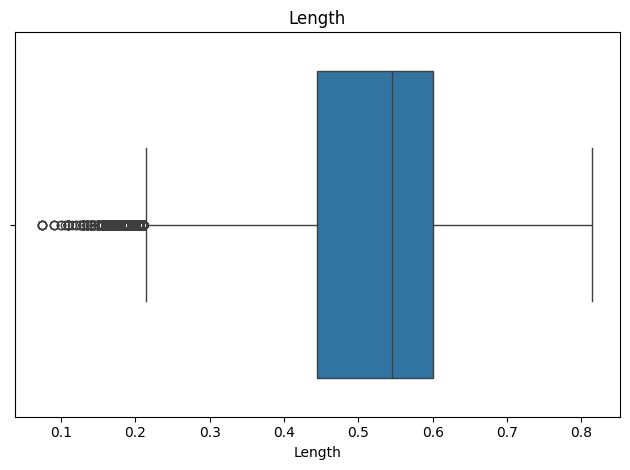

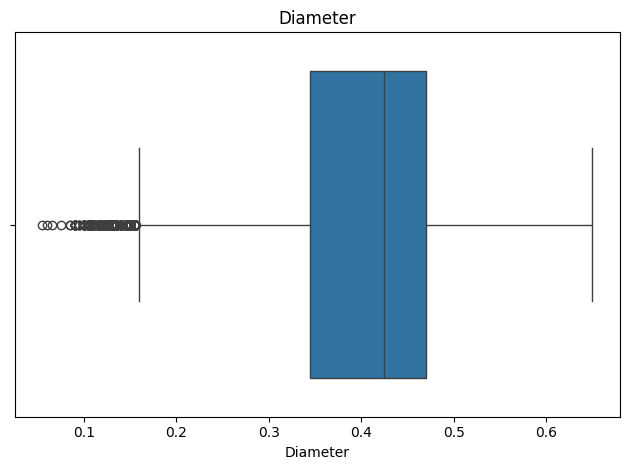

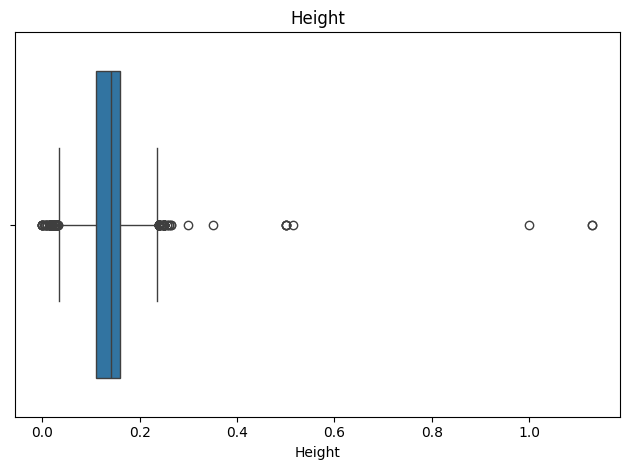

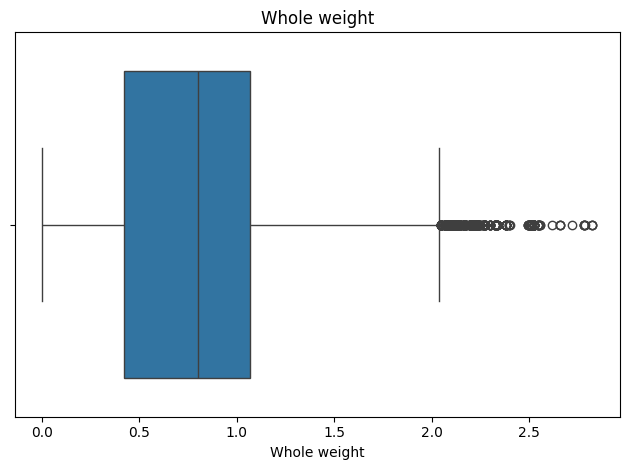

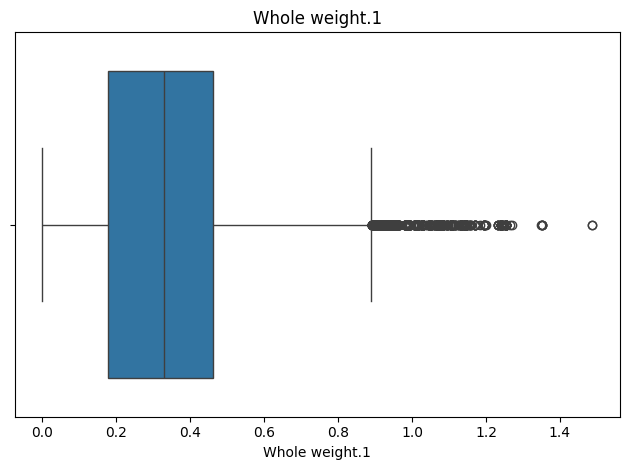

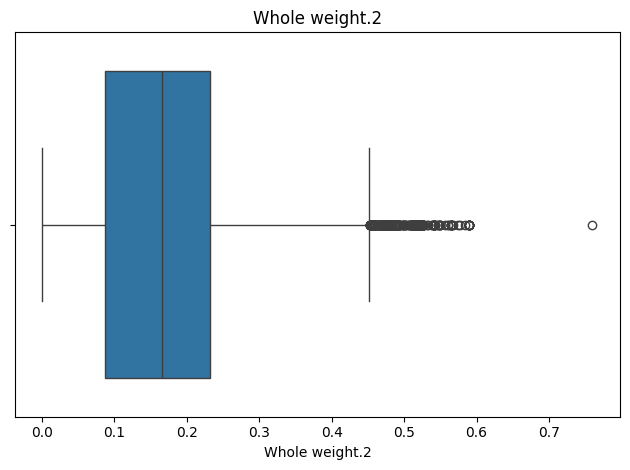

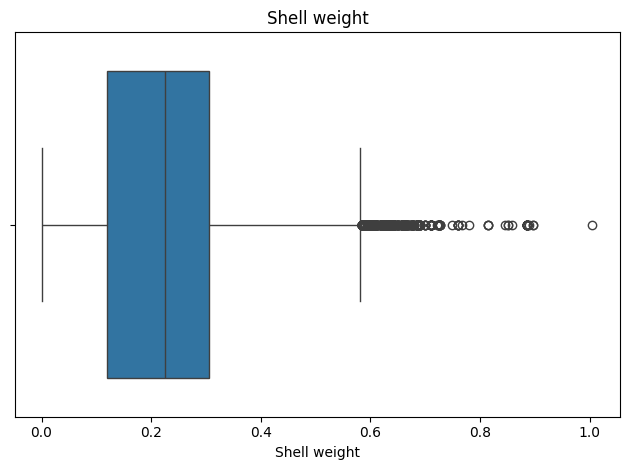

In [120]:
for col in numerical_features2:
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_limit = Q1 - 1.5 * IQR
    upper_limit = Q3 + 1.5 * IQR

    # Sadece aykırı değerlere sahip sütunları çiz
    if any((df[col] < lower_limit) | (df[col] > upper_limit)):
        sns.boxplot(x=df[col])
        plt.title(col)
        plt.tight_layout()
        plt.show()
    else:
        print(f"{col} sütununda aykırı değer bulunmamaktadır.")

In [121]:
def aykiri_degerleri_min_max_sinirlar_ile_doldur(df, sutunlar):
    for col in sutunlar:
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1

        alt_sinir = Q1 - 1.5 * IQR
        ust_sinir = Q3 + 1.5 * IQR

        df.loc[df[col] < alt_sinir, col] = alt_sinir
        df.loc[df[col] > ust_sinir, col] = ust_sinir

    
        
    return df

# Aykırı değerleri düzeltmek istediğiniz sütunları seçin
secilen_sutunlar = numerical_features2

# Aykırı değerleri düzelt
df = aykiri_degerleri_min_max_sinirlar_ile_doldur(df, secilen_sutunlar)

In [122]:
for col in numerical_features2:
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_limit = Q1 - 1.5 * IQR
    upper_limit = Q3 + 1.5 * IQR

    # Sadece aykırı değerlere sahip sütunları çiz
    if any((df[col] < lower_limit) | (df[col] > upper_limit)):
        sns.boxplot(x=df[col])
        plt.title(col)
        plt.tight_layout()
        plt.show()
    else:
        print(f"{col} sütununda aykırı değer bulunmamaktadır.")

Length sütununda aykırı değer bulunmamaktadır.
Diameter sütununda aykırı değer bulunmamaktadır.
Height sütununda aykırı değer bulunmamaktadır.
Whole weight sütununda aykırı değer bulunmamaktadır.
Whole weight.1 sütununda aykırı değer bulunmamaktadır.
Whole weight.2 sütununda aykırı değer bulunmamaktadır.
Shell weight sütununda aykırı değer bulunmamaktadır.


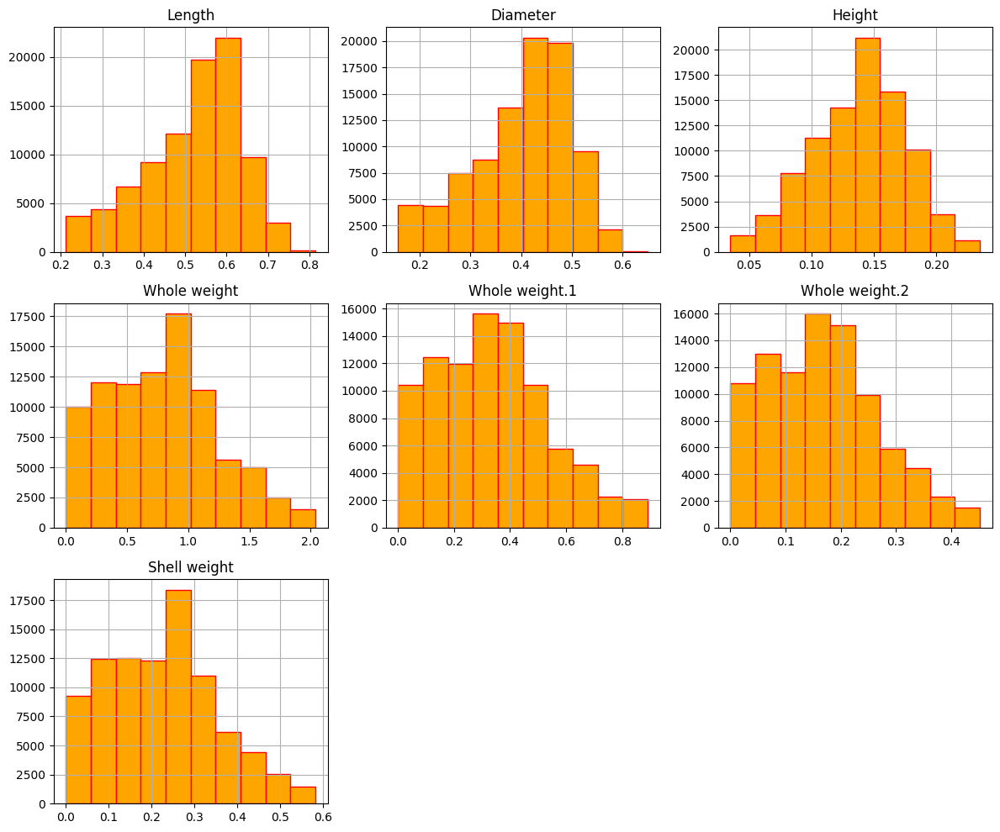

In [123]:
df[numerical_features2].hist(figsize=(12, 10), color='orange', edgecolor='red')
plt.tight_layout()
plt.show()

In [124]:
def sütunlari_veri_türune_gore_grupla(df):
    result_dict = {}

    for col, dtype in df.dtypes.items():
        dtype_str = str(dtype)
        
        if dtype_str not in result_dict:
            result_dict[dtype_str] = []
        
        result_dict[dtype_str].append(col)

    result_str = ""
    for dtype, columns in result_dict.items():
        result_str += f"\n{dtype} Veri Türü Sütunları:\n"
        result_str += ', '.join(columns) + '\n'
        result_str += '=' * 50 + '\n'

    return result_str

# df DataFrame'iniz olduğunu varsayalım
result = sütunlari_veri_türune_gore_grupla(df)

# Sonuçları görüntüleme
print(result)


object Veri Türü Sütunları:
Sex

float64 Veri Türü Sütunları:
Length, Diameter, Height, Whole weight, Whole weight.1, Whole weight.2, Shell weight

int64 Veri Türü Sütunları:
Rings



In [125]:
df.Sex.unique()

array(['F', 'I', 'M'], dtype=object)

In [126]:
from sklearn.preprocessing import OneHotEncoder
encoder = OneHotEncoder(sparse_output=False, drop='first', dtype=int)
target_columns = ["Sex"]
for target_column in target_columns:
    if df[target_column].dtype == 'object':
        encoded_values = encoder.fit(df[[target_column]])
        encoded_values = encoder.transform(df[[target_column]])
        encoded_columns = encoder.get_feature_names_out([target_column])
        df[encoded_columns] = encoded_values
        df.drop(columns=[target_column], inplace=True)
df.head()

,Length,Diameter,Height,Whole weight,Whole weight.1,Whole weight.2,Shell weight,Rings,Sex_I,Sex_M
0,0.5500,0.4300,0.150,0.7715,0.3285,0.1465,0.2400,11,0,0
1,0.6300,0.4900,0.145,1.1300,0.4580,0.2765,0.3200,11,0,0
2,0.2125,0.1575,0.035,0.0210,0.0055,0.0030,0.0050,6,1,0
3,0.5950,0.4750,0.150,0.9145,0.3755,0.2055,0.2500,10,0,1
4,0.5550,0.4250,0.130,0.7820,0.3695,0.1600,0.1975,9,1,0


In [127]:
# İstediğimiz bir kolonun yerini değiştirip sona almak

yer_değiştir = df.pop('Rings')
df['Rings'] = yer_değiştir
df.head(3)

,Length,Diameter,Height,Whole weight,Whole weight.1,Whole weight.2,Shell weight,Sex_I,Sex_M,Rings
0,0.5500,0.4300,0.150,0.7715,0.3285,0.1465,0.240,0,0,11
1,0.6300,0.4900,0.145,1.1300,0.4580,0.2765,0.320,0,0,11
2,0.2125,0.1575,0.035,0.0210,0.0055,0.0030,0.005,1,0,6


In [128]:
x = df.iloc[:,:-1].values
y = df.iloc[:,-1].values

In [129]:
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=0.2,random_state=42)

In [130]:
from sklearn.preprocessing import MinMaxScaler
scaler=MinMaxScaler()
x_train=scaler.fit_transform(x_train)
x_test=scaler.transform(x_test)

In [132]:
from sklearn.metrics import mean_squared_error, mean_squared_log_error,r2_score
from sklearn.model_selection import cross_val_score
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, AdaBoostRegressor
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from catboost import CatBoostRegressor

# neg_mean_squared_error:
models = [
          ('KNN', KNeighborsRegressor()),
          ('CART', DecisionTreeRegressor()),
          ('RF', RandomForestRegressor()),
          ("AdaBoost", AdaBoostRegressor()),
          ('GBM', GradientBoostingRegressor()),
          ("XGBoost", XGBRegressor(objective='reg:squarederror')),
          ("LightGBM", LGBMRegressor(verbosity=-1)),
          ("CatBoost", CatBoostRegressor(verbose=False))]

neg_mean_squared_error_list = []

for name, reg in models:
    cvs = cross_val_score(reg, 
                         x_test, y_test,
                         cv=5,
                         scoring="neg_mean_squared_error", n_jobs=-1)
    
    print("neg_mean_squared_error-->", cvs.mean(), name)
    
    neg_mean_squared_error_list.append(cvs.mean())
    neg_mean_squared_error_list.append(name)

neg_mean_squared_error--> -4.2647169618634395 KNN
neg_mean_squared_error--> -7.544406363705565 CART
neg_mean_squared_error--> -3.7721339558823472 RF
neg_mean_squared_error--> -9.102921337347789 AdaBoost
neg_mean_squared_error--> -3.7355686672977746 GBM
neg_mean_squared_error--> -3.8884638555503015 XGBoost
neg_mean_squared_error--> -3.6067598822648947 LightGBM
neg_mean_squared_error--> -3.6096456031845654 CatBoost


In [133]:
# r2:
models = [
          ('KNN', KNeighborsRegressor()),
          ('CART', DecisionTreeRegressor()),
          ('RF', RandomForestRegressor()),
          ("AdaBoost", AdaBoostRegressor()),
          ('GBM', GradientBoostingRegressor()),
          ("XGBoost", XGBRegressor(objective='reg:squarederror')),
          ("LightGBM", LGBMRegressor(verbosity=-1)),
          ("CatBoost", CatBoostRegressor(verbose=False))]

r2_score_list = []

for name, reg in models:
    cvs = cross_val_score(reg, 
                         x_test, y_test,
                         cv=5,
                         scoring="r2", n_jobs=-1)
    
    print("r2-->", cvs.mean(), name)
    
    r2_score_list.append(cvs.mean())
    r2_score_list.append(name)

r2--> 0.5848451922143298 KNN
r2--> 0.26008939775113105 CART
r2--> 0.6320226558364904 RF
r2--> 0.054572550949217626 AdaBoost
r2--> 0.636442373400363 GBM
r2--> 0.6213814748361128 XGBoost
r2--> 0.6490138547496018 LightGBM
r2--> 0.6487328172602516 CatBoost


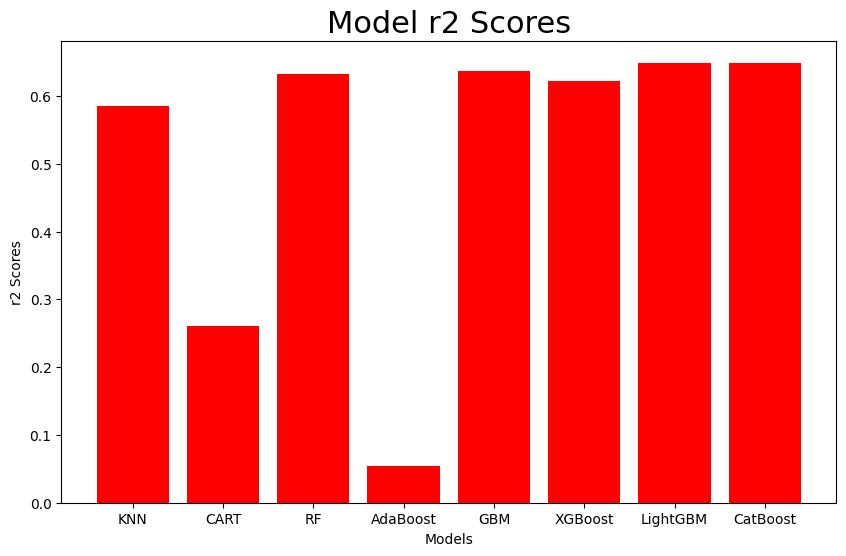

In [134]:
models = r2_score_list[1::2]
r2 = r2_score_list[::2]

plt.figure(figsize=(10, 6))
plt.bar(models, r2, color="red")
plt.xlabel('Models')
plt.ylabel('r2 Scores')
plt.title('Model r2 Scores', fontsize=22)
plt.show()

In [135]:
import optuna
import pandas as pd
from sklearn.model_selection import cross_val_predict, KFold
from lightgbm import LGBMRegressor
from sklearn.metrics import root_mean_squared_log_error
import optuna.logging
optuna.logging.set_verbosity(optuna.logging.WARNING)


cv = KFold(n_splits=5, shuffle=True, random_state=42)
best_params = {}
best_rmsle = float('inf')

def objective(trial, x_train, y_train):
    params = {
        'learning_rate': trial.suggest_float('learning_rate', 0.01, 0.1),
        'n_estimators': trial.suggest_int('n_estimators', 300, 4000),
        'max_depth': trial.suggest_int('max_depth', 1, 10),
        'subsample': trial.suggest_float('subsample', 0.1, 1.0),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.1, 1.0),
        'min_child_weight': trial.suggest_int('min_child_weight', 1, 10),
        'num_leaves': trial.suggest_int('num_leaves', 10, 50),
        'reg_alpha': trial.suggest_float('reg_alpha', 0.0, 1.0),
        'reg_lambda': trial.suggest_float('reg_lambda', 0.0, 1.0),
        'learning_rate_decay_power': trial.suggest_float('learning_rate_decay_power', 0.1, 0.9),
        'min_split_gain': trial.suggest_float('min_split_gain', 0.0, 1.0)
    }

    model = LGBMRegressor(**params, verbose=0)
    y_pred = cross_val_predict(model, x_train, y_train, cv=cv)
    rmsle = root_mean_squared_log_error(y_train, y_pred)
    global best_rmsle, best_params
    if rmsle < best_rmsle:
        best_rmsle = rmsle
        best_params = params
    return rmsle

study = optuna.create_study(direction='minimize')
study.optimize(lambda trial: objective(trial, x_train, y_train), n_trials=50)


[LightGBM] [Warning] Unknown parameter: learning_rate_decay_power
[LightGBM] [Warning] Unknown parameter: learning_rate_decay_power
[LightGBM] [Warning] Unknown parameter: learning_rate_decay_power
[LightGBM] [Warning] Unknown parameter: learning_rate_decay_power
[LightGBM] [Warning] Unknown parameter: learning_rate_decay_power
[LightGBM] [Warning] Unknown parameter: learning_rate_decay_power
[LightGBM] [Warning] Unknown parameter: learning_rate_decay_power
[LightGBM] [Warning] Unknown parameter: learning_rate_decay_power
[LightGBM] [Warning] Unknown parameter: learning_rate_decay_power
[LightGBM] [Warning] Unknown parameter: learning_rate_decay_power
[LightGBM] [Warning] Unknown parameter: learning_rate_decay_power
[LightGBM] [Warning] Unknown parameter: learning_rate_decay_power
[LightGBM] [Warning] Unknown parameter: learning_rate_decay_power
[LightGBM] [Warning] Unknown parameter: learning_rate_decay_power
[LightGBM] [Warning] Unknown parameter: learning_rate_decay_power
[LightGBM]

In [136]:
print("Best Parameters for LightGBM:")
print("Best RMSLE:", best_rmsle)
print(best_params)

Best Parameters for LightGBM:
Best RMSLE: 0.1490045758211621
{'learning_rate': 0.027929882964301968, 'n_estimators': 3759, 'max_depth': 9, 'subsample': 0.4266702332947614, 'colsample_bytree': 0.6352959683614894, 'min_child_weight': 5, 'num_leaves': 37, 'reg_alpha': 0.9791432971308394, 'reg_lambda': 0.8442789130154593, 'learning_rate_decay_power': 0.2662834081542303, 'min_split_gain': 0.5474740728448446}


In [142]:
from lightgbm import LGBMRegressor
regressor = LGBMRegressor(learning_rate=0.027929882964301968,n_estimators=3759,max_depth=9,subsample=0.4266702332947614,colsample_bytree=0.6352959683614894,min_child_weight=5,num_leaves=37,reg_alpha=0.9791432971308394,reg_lambda=0.8442789130154593,learning_rate_decay_power=0.2662834081542303,min_split_gain=0.5474740728448446)
regressor.fit(x_train,y_train)

[LightGBM] [Warning] Unknown parameter: learning_rate_decay_power
[LightGBM] [Warning] Unknown parameter: learning_rate_decay_power
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003770 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1280
[LightGBM] [Info] Number of data points in the train set: 72492, number of used features: 9
[LightGBM] [Info] Start training from score 9.697111
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[L

LGBMRegressor(colsample_bytree=0.6352959683614894,
              learning_rate=0.027929882964301968,
              learning_rate_decay_power=0.2662834081542303, max_depth=9,
              min_child_weight=5, min_split_gain=0.5474740728448446,
              n_estimators=3759, num_leaves=37, reg_alpha=0.9791432971308394,
              reg_lambda=0.8442789130154593, subsample=0.4266702332947614)

In [143]:
y_pred_train = regressor.predict(x_train)
y_pred = regressor.predict(x_test)

[LightGBM] [Warning] Unknown parameter: learning_rate_decay_power
[LightGBM] [Warning] Unknown parameter: learning_rate_decay_power


In [144]:
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error,root_mean_squared_log_error
print("Train seti")
r2 = r2_score(y_train, y_pred_train)
mse = mean_squared_error(y_train, y_pred_train)
mae = mean_absolute_error(y_train, y_pred_train)
rmse = mean_squared_error(y_train, y_pred_train, squared=False)
rmsle = root_mean_squared_log_error(y_train, y_pred_train)

print("r2_Score:", r2)
print("mse:", mse)
print("mae:", mae)
print("rmse:", rmse)
print("rmsle:",rmsle)

print()

print("Test seti")
r2 = r2_score(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
rmse = mean_squared_error(y_test, y_pred, squared=False)
rmsle = root_mean_squared_log_error(y_test, y_pred)
print("r2_Score:", r2)
print("mse:", mse)
print("mae:", mae)
print("rmse:", rmse)
print("rmsle:",rmsle)


Train seti
r2_Score: 0.7339457945831092
mse: 2.6717816997417465
mae: 1.1240391218479218
rmse: 1.6345585641823135
rmsle: 0.13708194650717243

Test seti
r2_Score: 0.6670274899297173
mse: 3.4204121486365087
mae: 1.24417270182114
rmse: 1.8494356297629038
rmsle: 0.15085861400383713


In [38]:
regressor.fit(x,y)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.006188 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1282
[LightGBM] [Info] Number of data points in the train set: 90615, number of used features: 9
[LightGBM] [Info] Start training from score 9.696794
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, 

LGBMRegressor(colsample_bytree=0.5785385362949301,
              learning_rate=0.010438858342812418, max_depth=6,
              min_child_weight=7, n_estimators=2994, num_leaves=50,
              subsample=0.797659358302171)

# Unseen data seti işlemleri

In [67]:
df1 = pd.read_csv("test.csv",delimiter=",")
df1.head(3)

,id,Sex,Length,Diameter,Height,Whole weight,Whole weight.1,Whole weight.2,Shell weight
0,90615,M,0.645,0.475,0.155,1.2380,0.6185,0.3125,0.3005
1,90616,M,0.580,0.460,0.160,0.9830,0.4785,0.2195,0.2750
2,90617,M,0.560,0.420,0.140,0.8395,0.3525,0.1845,0.2405


In [68]:
yeni_df = df1.drop(columns="id")

In [69]:
numerical_features1 = [feature for feature in yeni_df.columns if yeni_df[feature].dtypes != 'O']
print('Number of numerical variables: ', len(numerical_features1))
# sayısal değişkenleri görelim
yeni_df[numerical_features1].head()

Number of numerical variables:  7


,Length,Diameter,Height,Whole weight,Whole weight.1,Whole weight.2,Shell weight
0,0.645,0.475,0.155,1.2380,0.6185,0.3125,0.3005
1,0.580,0.460,0.160,0.9830,0.4785,0.2195,0.2750
2,0.560,0.420,0.140,0.8395,0.3525,0.1845,0.2405
3,0.570,0.490,0.145,0.8740,0.3525,0.1865,0.2350
4,0.415,0.325,0.110,0.3580,0.1575,0.0670,0.1050


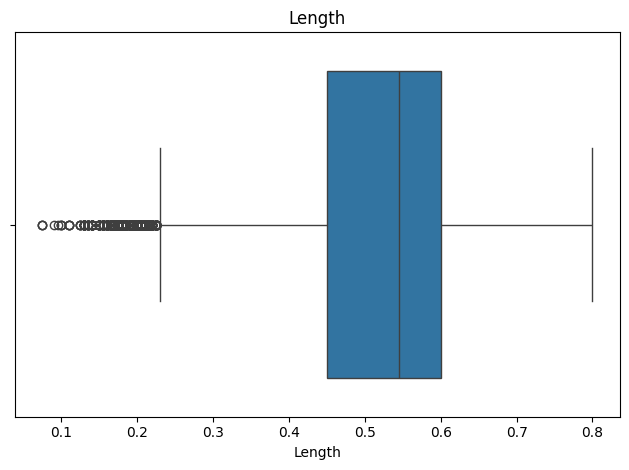

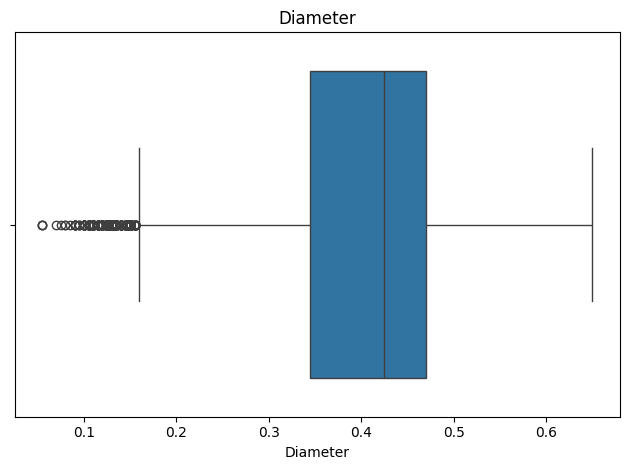

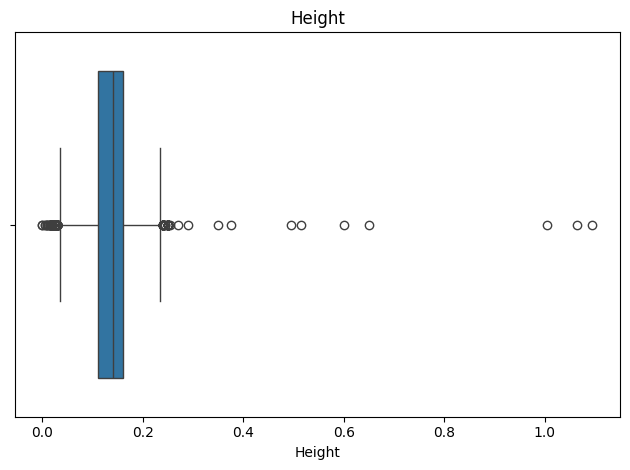

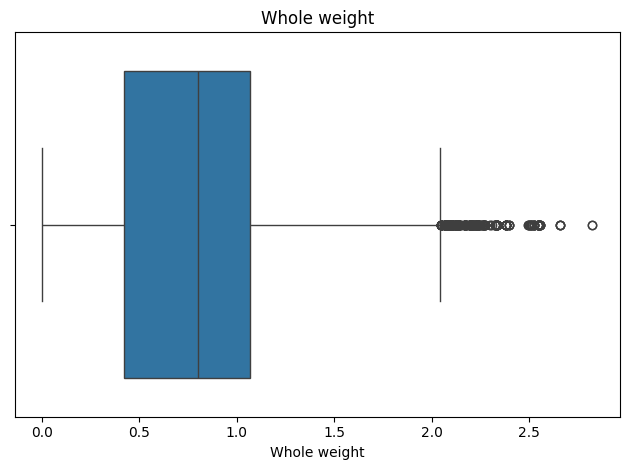

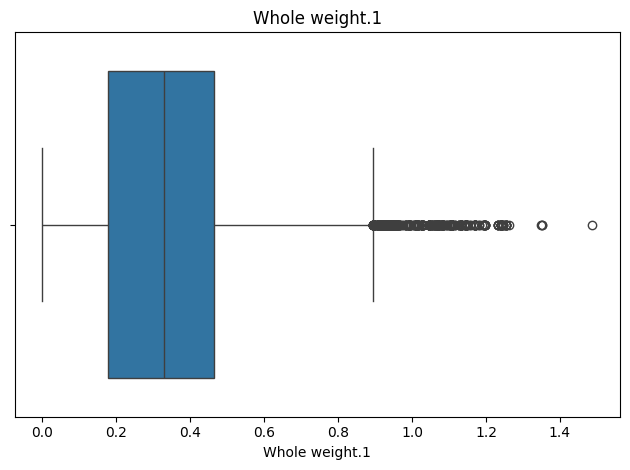

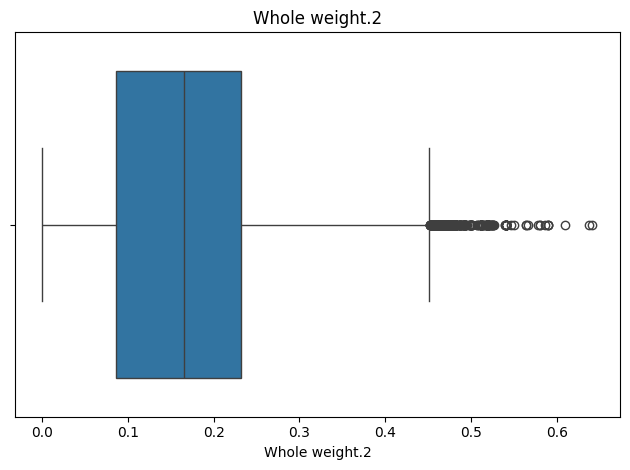

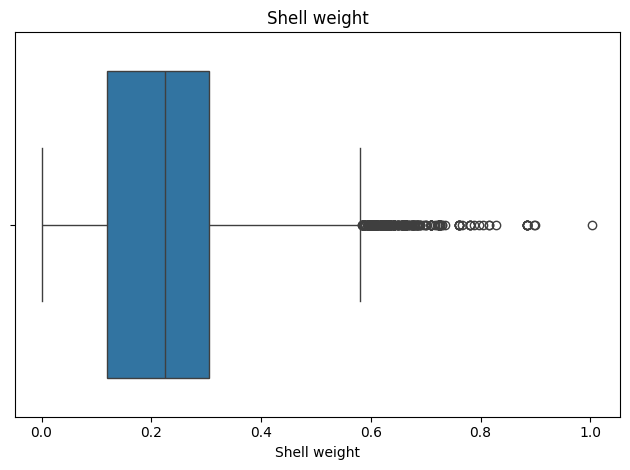

In [73]:
for col in numerical_features1:
    Q1 = yeni_df[col].quantile(0.25)
    Q3 = yeni_df[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_limit = Q1 - 1.5 * IQR
    upper_limit = Q3 + 1.5 * IQR

    # Sadece aykırı değerlere sahip sütunları çiz
    if any((yeni_df[col] < lower_limit) | (yeni_df[col] > upper_limit)):
        sns.boxplot(x=yeni_df[col])
        plt.title(col)
        plt.tight_layout()
        plt.show()
    else:
        print(f"{col} sütununda aykırı değer bulunmamaktadır.")

In [74]:
def aykiri_degerleri_min_max_sinirlar_ile_doldur(df, sutunlar):
    for col in sutunlar:
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1

        alt_sinir = Q1 - 1.5 * IQR
        ust_sinir = Q3 + 1.5 * IQR

        df.loc[df[col] < alt_sinir, col] = alt_sinir
        df.loc[df[col] > ust_sinir, col] = ust_sinir

    
        
    return df

# Aykırı değerleri düzeltmek istediğiniz sütunları seçin
secilen_sutunlar = numerical_features

# Aykırı değerleri düzelt
yeni_df = aykiri_degerleri_min_max_sinirlar_ile_doldur(yeni_df, secilen_sutunlar)

In [75]:
for col in numerical_features1:
    Q1 = yeni_df[col].quantile(0.25)
    Q3 = yeni_df[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_limit = Q1 - 1.5 * IQR
    upper_limit = Q3 + 1.5 * IQR

    # Sadece aykırı değerlere sahip sütunları çiz
    if any((yeni_df[col] < lower_limit) | (yeni_df[col] > upper_limit)):
        sns.boxplot(x=yeni_df[col])
        plt.title(col)
        plt.tight_layout()
        plt.show()
    else:
        print(f"{col} sütununda aykırı değer bulunmamaktadır.")

Length sütununda aykırı değer bulunmamaktadır.
Diameter sütununda aykırı değer bulunmamaktadır.
Height sütununda aykırı değer bulunmamaktadır.
Whole weight sütununda aykırı değer bulunmamaktadır.
Whole weight.1 sütununda aykırı değer bulunmamaktadır.
Whole weight.2 sütununda aykırı değer bulunmamaktadır.
Shell weight sütununda aykırı değer bulunmamaktadır.


In [77]:
target_columns = ["Sex"]
for target_column in target_columns:
    if yeni_df[target_column].dtype == 'object':
        encoded_values = encoder.transform(yeni_df[[target_column]])
        encoded_columns = encoder.get_feature_names_out([target_column])
        yeni_df[encoded_columns] = encoded_values
        yeni_df.drop(columns=[target_column], inplace=True)
yeni_df.head()

,Length,Diameter,Height,Whole weight,Whole weight.1,Whole weight.2,Shell weight,Sex_I,Sex_M
0,0.645,0.475,0.155,1.2380,0.6185,0.3125,0.3005,0,1
1,0.580,0.460,0.160,0.9830,0.4785,0.2195,0.2750,0,1
2,0.560,0.420,0.140,0.8395,0.3525,0.1845,0.2405,0,1
3,0.570,0.490,0.145,0.8740,0.3525,0.1865,0.2350,0,1
4,0.415,0.325,0.110,0.3580,0.1575,0.0670,0.1050,1,0


In [78]:
unseen = yeni_df.iloc[:, :]
unseen.head(3)

,Length,Diameter,Height,Whole weight,Whole weight.1,Whole weight.2,Shell weight,Sex_I,Sex_M
0,0.645,0.475,0.155,1.2380,0.6185,0.3125,0.3005,0,1
1,0.580,0.460,0.160,0.9830,0.4785,0.2195,0.2750,0,1
2,0.560,0.420,0.140,0.8395,0.3525,0.1845,0.2405,0,1


In [79]:
y_pred = regressor.predict(unseen)
y_pred

array([ 9.73223895,  9.75865839,  9.93759296, ..., 12.72477578,
       14.216703  ,  8.35215463])

In [85]:
df1["Rings"] = y_pred
df1.head()

,id,Sex,Length,Diameter,Height,Whole weight,Whole weight.1,Whole weight.2,Shell weight,Rings
0,90615,M,0.645,0.475,0.155,1.2380,0.6185,0.3125,0.3005,9.732239
1,90616,M,0.580,0.460,0.160,0.9830,0.4785,0.2195,0.2750,9.758658
2,90617,M,0.560,0.420,0.140,0.8395,0.3525,0.1845,0.2405,9.937593
3,90618,M,0.570,0.490,0.145,0.8740,0.3525,0.1865,0.2350,10.441027
4,90619,I,0.415,0.325,0.110,0.3580,0.1575,0.0670,0.1050,7.624992


In [86]:
summission_df = df1[["id","Rings"]]
summission_df.head(3)

,id,Rings
0,90615,9.732239
1,90616,9.758658
2,90617,9.937593


In [87]:
# Temizlenmiş veriyi CSV dosyasına kaydetmek

summission_df.to_csv('sample_submission.csv', index=False)